In [ ]:
# !wget https://www.dropbox.com/s/2xltmolfbfharri/apples_oranges.zip
# !unzip apples_oranges.zip

In [ ]:
!pip install torch_snippets
import itertools
import torch.cuda
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


2022-03-16 14:42:00.437 | WARNING  | torch_snippets.loader:<module>:101 - Skipping cv2 import


### **Define the image transformation pipeline (transform)**

In [ ]:
# TODO: Image transformation pipelines
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([transforms.Resize(int(IMAGE_SIZE * 1.33)),
                                transforms.RandomCrop((IMAGE_SIZE, IMAGE_SIZE)),
                                transforms.RandomHorizontalFlip(),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ])

### **Define the CycleGAN dataset class**:
> Define the dataset class (CycleGANDataset), which takes the apple and
orange folders (which are obtained after unzipping the downloaded
dataset) as input and provides a batch of apple and orange images

In [ ]:
# TODO: Define the CycleGAN dataset class
class CycleGANDataset(Dataset):
    def __init__(self, apples, oranges):
        self.apples = Glob(apples)
        self.oranges = Glob(oranges)

    def __getitem__(self, ix):
        apple = self.apples[ix % len(self.apples)]
        orange = choose(self.oranges)
        apple = Image.open(apple).convert('RGB')
        orange = Image.open(orange).convert('RGB')
        return apple, orange

    def __len__(self):
        return max(len(self.apples), len(self.oranges))

    def choose(self):
        return self[randint(len(self))]

    def collate_fn(self, batch):
        sources, targets = list(zip(*batch))
        sources = torch.cat([transform(img)[None] for img in sources], 0).to(device).float()
        targets = torch.cat([transform(img)[None] for img in targets], 0).to(device).float()
        return sources.to(device), targets.to(device)


### **Define the training and validation datasets and data loaders**:

In [ ]:
# TODO: Define training and validation dataset and DataLoader
train_ds = CycleGANDataset('cycle_gan_data/apples_train', 'cycle_gan_data/oranges_train')
valid_ds = CycleGANDataset('cycle_gan_data/apples_test', 'cycle_gan_data/oranges_test')

train_loader = DataLoader(train_ds, batch_size=1, shuffle=True, collate_fn=train_ds.collate_fn)
valid_loader = DataLoader(valid_ds, batch_size=5, shuffle=True, collate_fn=valid_ds.collate_fn)

In [ ]:
print(len(train_loader), len(valid_loader))

3067 205


### **Define the weight initialization method of the network 'weights_init_normal'**

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, 'bias') and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find('BatchNorm2d') != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

In [ ]:
### **Define the residual block network (ResidualBlock), as in this instance, we will leverage the ResNet**

In [ ]:
# TODO: Define the residual block network (ResidualBlock)
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(nn.ReflectionPad2d(1),
                                   nn.Conv2d(in_features, in_features, 3),
                                   nn.InstanceNorm2d(in_features),
                                   nn.ReLU(inplace=True),
                                   nn.ReflectionPad2d(1),
                                   nn.Conv2d(in_features, in_features, 3),
                                   nn.InstanceNorm2d(in_features),
                                   )

    def forward(self, x):
        return x + self.block(x)

In [ ]:
### **Define the generator network (GeneratorResNet)**

In [ ]:
# TODO: Generator Network(GeneratorResNet)
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_block=9):
        super(GeneratorResNet, self).__init__()

        out_features = 64
        channels = 3

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(channels, out_features, 7),
                 nn.InstanceNorm2d(out_features),
                 nn.ReLU(inplace=True)]

        in_features = out_features

        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                      nn.InstanceNorm2d(out_features),
                      nn.ReLU(inplace=True)]

            in_features = out_features

        # Residual Block
        for _ in range(num_residual_block):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [nn.Upsample(scale_factor=2),
                      nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                      nn.InstanceNorm2d(out_features),
                      nn.ReLU(inplace=True)]

            in_features = out_features

        # Output layers
        model += [nn.ReflectionPad2d(channels),
                  nn.Conv2d(out_features, channels, 7),
                  nn.Tanh()]

        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)

    def forward(self, x):
        return self.model(x)



In [ ]:
### **Define the Discriminator Network(Discriminator)**

In [ ]:
# TODO: Define the Discriminator Network(Discriminator)
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """ Return downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))

            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(*discriminator_block(channels, 64, normalize=False),
                                   *discriminator_block(64, 128),
                                   *discriminator_block(128, 256),
                                   *discriminator_block(256, 512),
                                   nn.ZeroPad2d((1, 0, 1, 0)),
                                   nn.Conv2d(512, 1, 4, padding=1))

        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)



In [ ]:
### **Define the function to generate a sample of **`images – generate_sample`** **

In [ ]:
# TODO: Define the function to generate a sample of images – generate_sample
@torch.no_grad()
def generate_sample():
    data = next(iter(valid_loader))
    G_AB.eval()
    G_BA.eval()
    real_A, real_B = data
    fake_A = G_BA(real_B)
    fake_B = G_AB(real_A)
    # Arrange image along with x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)

    # Arrange image along with y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1, 2, 0).numpy(), sz=12)


### **Define the function to train the generator (generator_train_step)**
> The function takes the two generator models (`G_AB and G_BA as Gs`),
optimizer, and real images of the two classes **– real_A and real_B –** as
input: 
```python
def generator_train_step(Gs, optimizer, real_A, real_B):
```

> Specify the generators:
```python
G_AB, G_BA = Gs
```

> Set gradients to zero for the optimizer:
```python
optimizer.zero_grad()
```

> If you were to send an orange image to an orange-generator, ideally, if the
generator has understood everything about oranges, it should not make
any changes to the image and should "generate" the exact image. We thus
create an identity using this knowledge. The loss function corresponding to
criterion_identity will be given just prior to training the model.
Calculate the identity loss (loss_identity) for images of type A (apples)
and type B (oranges):

```python
loss_id_A = criterion_identity(G_BA(real_A), real_A)
loss_id_B = criterion_identity(G_AB(real_B), real_B)
loss_identity = (loss_id_A + loss_id_B) / 2
```

> Calculate the GAN loss when the image is passed through the generator
and the generated image is expected to be as close to the other class as
possible (we have np.ones in this case when training the generator, as we
are passing the fake images of a class to the discriminator of the same
class):

```python
fake_B = G_AB(real_A)
loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
fake_A = G_BA(real_B)
loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_B), 1, 16, 16))).to(device))

loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
```

> Calculate the cycle loss. Consider a scenario where an image of an apple is
to be transformed by an orange-generator to generate a fake orange, and
such a fake orange is to be transformed back to an apple by the applegenerator. If the generators were perfect, this process should give back the original image, which means the following cycle losses should be zero:

```python
recov_A = G_BA(fake_B)
loss_cycle_A = criterion_cycle(recov_A, real_A)
recov_B = G_AB(fake_A)
loss_cycle_B = criterion_cycle(recov_B, real_B)
loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
```

In [ ]:
# TODO: Define the generator_train_step function
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()

    # Calculate Identity loss, orange can identity orange and apple can identity apple
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2

    # Calculate the GAN loss, orange can convert into apple and vice versa
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2

    # Calculate the cycle loss, apple is transferred into orange-generator, then transferred back to original apple by
    # apple generator
    recover_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recover_A, real_A)
    recover_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recover_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2

    # Calculate the overall loss and perform backpropagation before returning the calculated values
    loss_G = loss_cycle * lambda_cyc + lambda_id * loss_identity + loss_GAN
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B



In [ ]:
### **Define the function to train the discriminator(`discriminator_train_step`):**

In [ ]:
# TODO: Define the discriminator_train_step function
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D

In [ ]:
### **Define the generator, discriminator objects, optimizers, and loss functions **

In [ ]:
# TODO: Define the generator, discriminator objects, optimizers, and loss functions
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

optimizer_G = optim.Adam(itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_A = optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

In [ ]:
### **Train the networks over increasing epochs**

EPOCH: 0.000	loss_D: 1.266	loss_G: 10.764	loss_identity: 0.581	loss_GAN: 1.672	loss_cycle: 0.619	(2.37s - 72580.28s remaining)

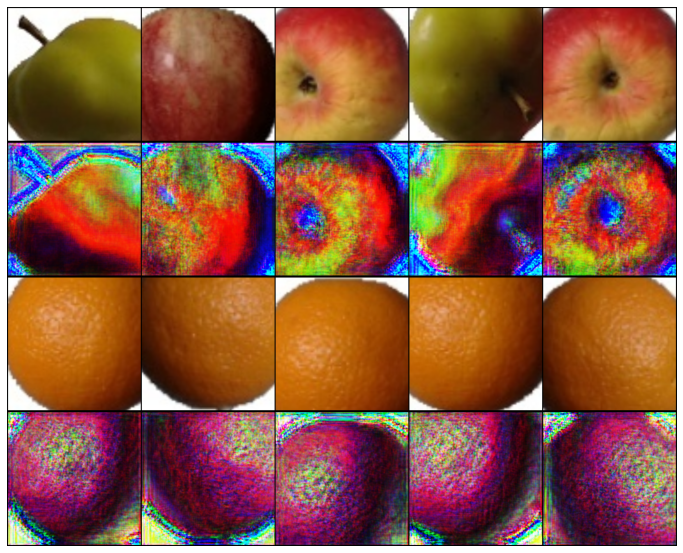

EPOCH: 0.033	loss_D: 0.243	loss_G: 2.086	loss_identity: 0.109	loss_GAN: 0.343	loss_cycle: 0.120	(120.90s - 36591.55s remaining)

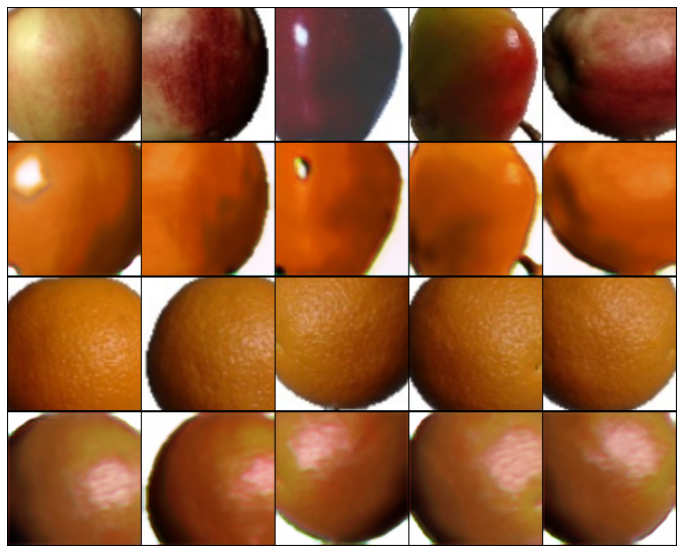

EPOCH: 0.066	loss_D: 0.140	loss_G: 2.851	loss_identity: 0.148	loss_GAN: 0.546	loss_cycle: 0.157	(240.09s - 36395.18s remaining)

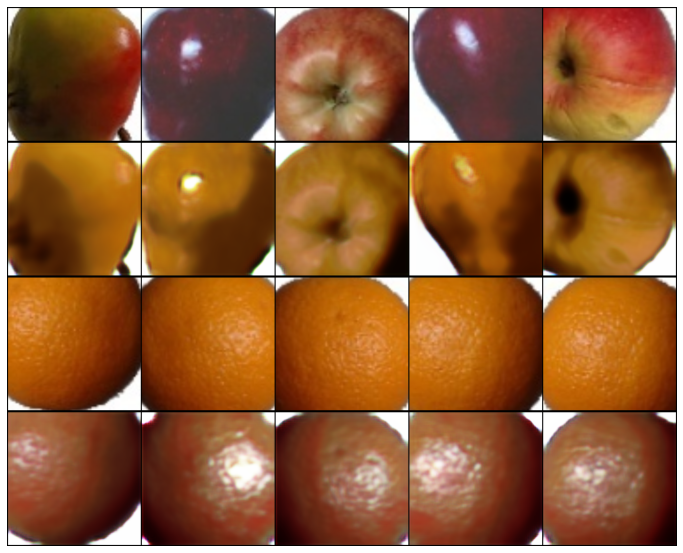

EPOCH: 0.098	loss_D: 0.269	loss_G: 3.173	loss_identity: 0.193	loss_GAN: 0.267	loss_cycle: 0.194	(359.71s - 36292.67s remaining)

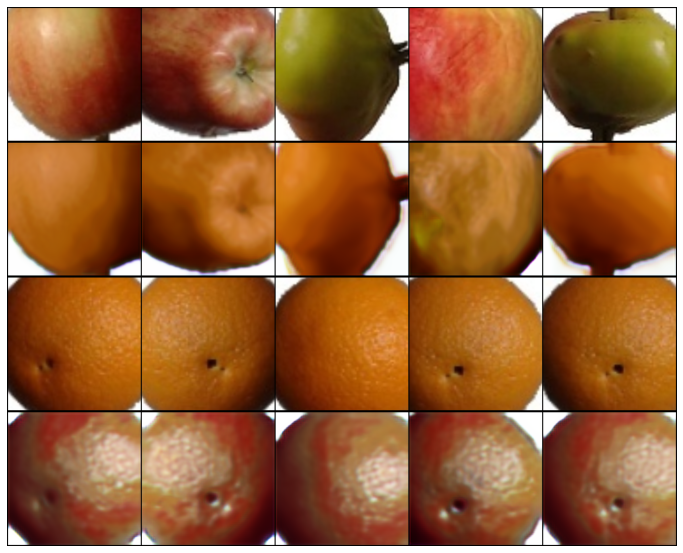

EPOCH: 0.131	loss_D: 0.184	loss_G: 2.157	loss_identity: 0.113	loss_GAN: 0.403	loss_cycle: 0.119	(479.26s - 36176.41s remaining)

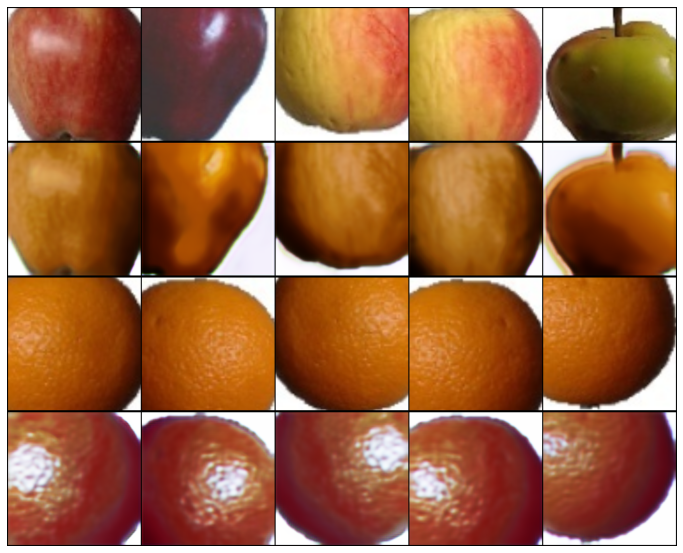

EPOCH: 0.163	loss_D: 0.243	loss_G: 2.137	loss_identity: 0.118	loss_GAN: 0.350	loss_cycle: 0.120	(603.20s - 36323.15s remaining)

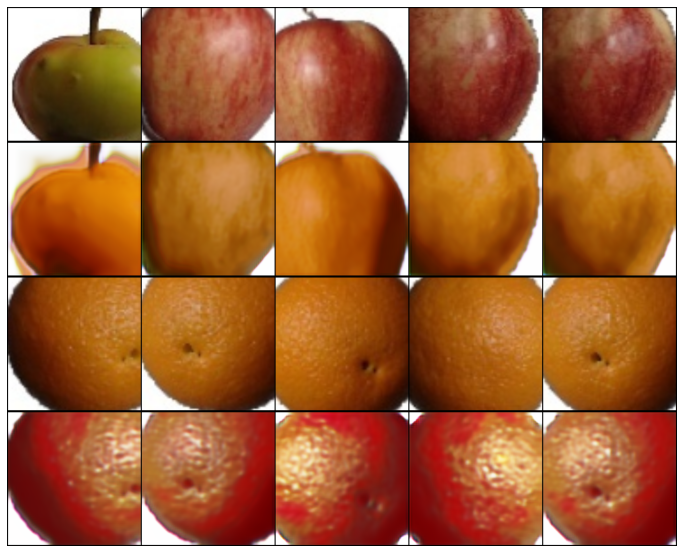

EPOCH: 0.196	loss_D: 0.264	loss_G: 2.579	loss_identity: 0.146	loss_GAN: 0.363	loss_cycle: 0.149	(722.79s - 36162.49s remaining)

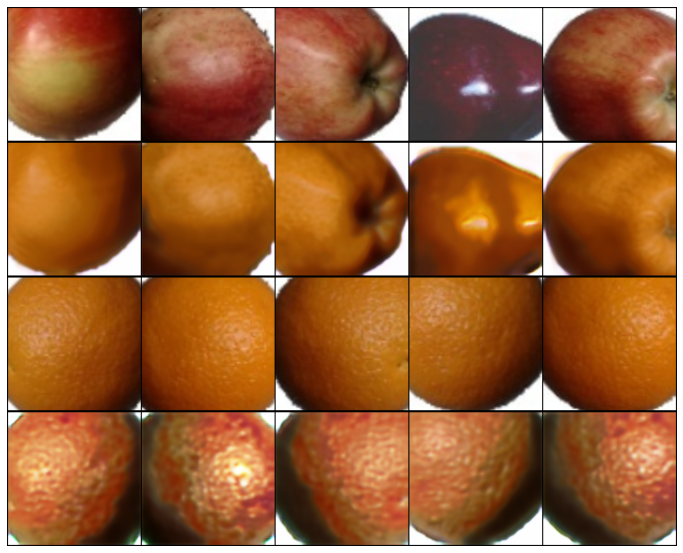

EPOCH: 0.229	loss_D: 0.222	loss_G: 2.740	loss_identity: 0.150	loss_GAN: 0.432	loss_cycle: 0.156	(842.09s - 36000.99s remaining)

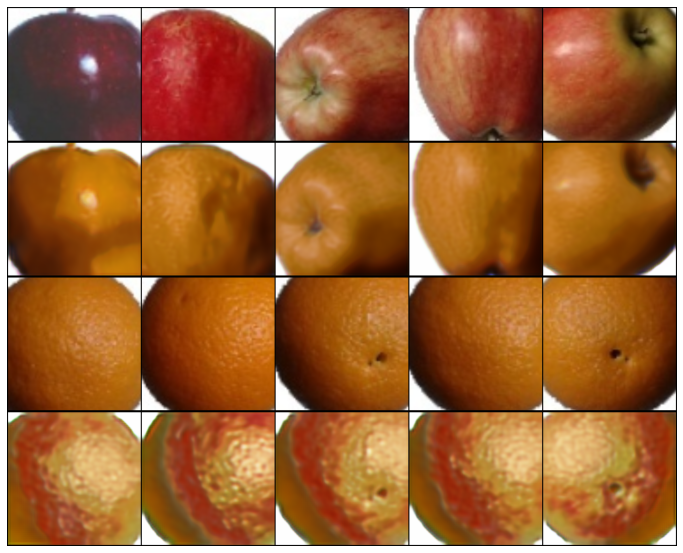

EPOCH: 0.261	loss_D: 0.157	loss_G: 2.305	loss_identity: 0.104	loss_GAN: 0.431	loss_cycle: 0.135	(961.49s - 35853.43s remaining)

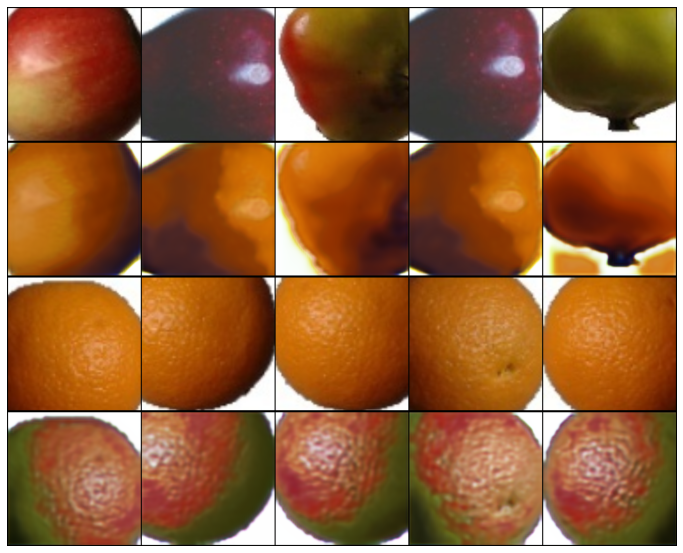

EPOCH: 0.294	loss_D: 0.113	loss_G: 2.741	loss_identity: 0.092	loss_GAN: 0.864	loss_cycle: 0.142	(1080.89s - 35712.47s remaining)

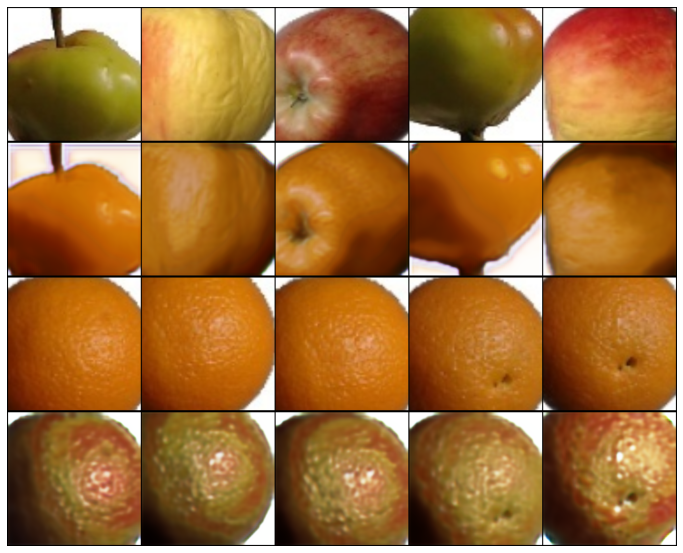

EPOCH: 0.326	loss_D: 0.296	loss_G: 2.061	loss_identity: 0.083	loss_GAN: 0.597	loss_cycle: 0.105	(1201.79s - 35620.34s remaining)

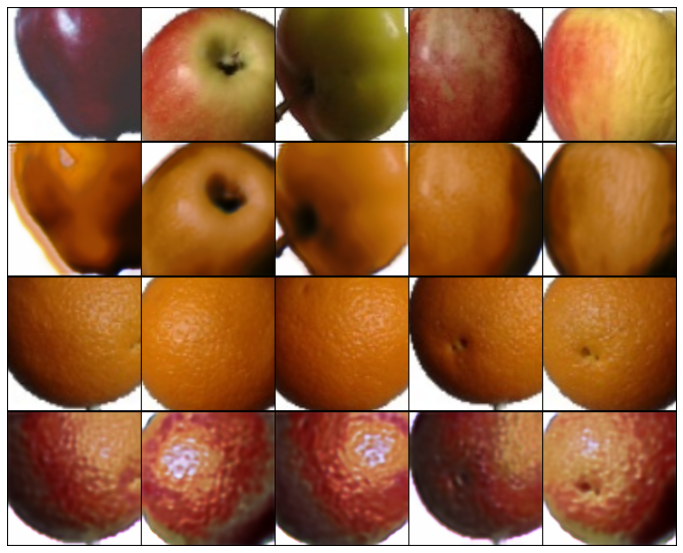

EPOCH: 0.359	loss_D: 0.079	loss_G: 1.715	loss_identity: 0.060	loss_GAN: 0.576	loss_cycle: 0.084	(1320.71s - 35469.60s remaining)

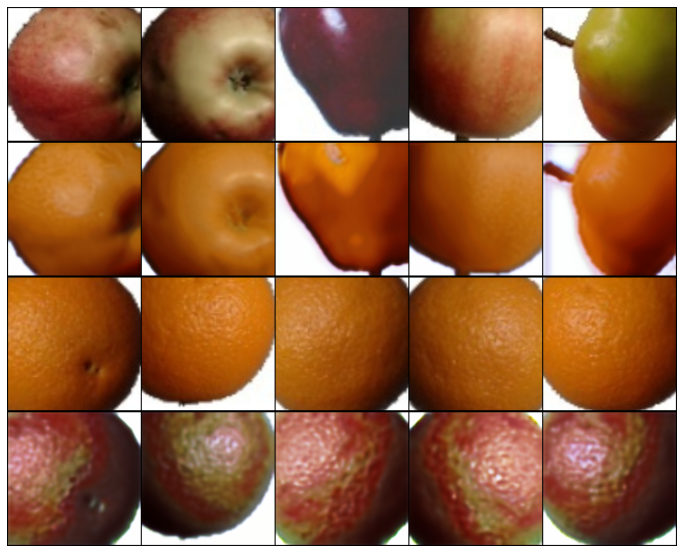

EPOCH: 0.392	loss_D: 0.115	loss_G: 1.972	loss_identity: 0.086	loss_GAN: 0.581	loss_cycle: 0.096	(1439.83s - 35329.10s remaining)

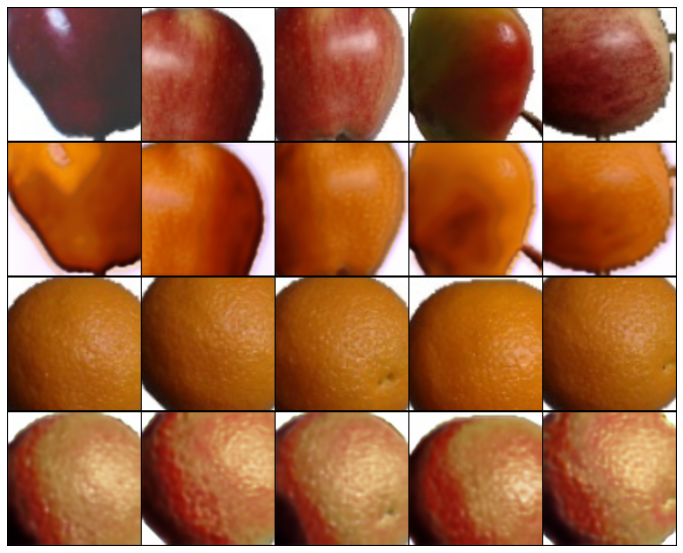

EPOCH: 0.424	loss_D: 0.221	loss_G: 1.481	loss_identity: 0.068	loss_GAN: 0.451	loss_cycle: 0.069	(1559.13s - 35196.01s remaining)

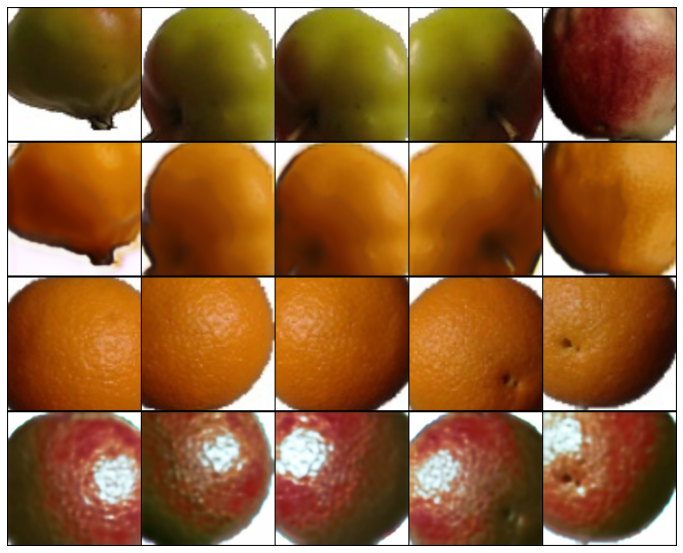

EPOCH: 0.457	loss_D: 0.244	loss_G: 3.469	loss_identity: 0.146	loss_GAN: 0.767	loss_cycle: 0.197	(1679.26s - 35082.35s remaining)

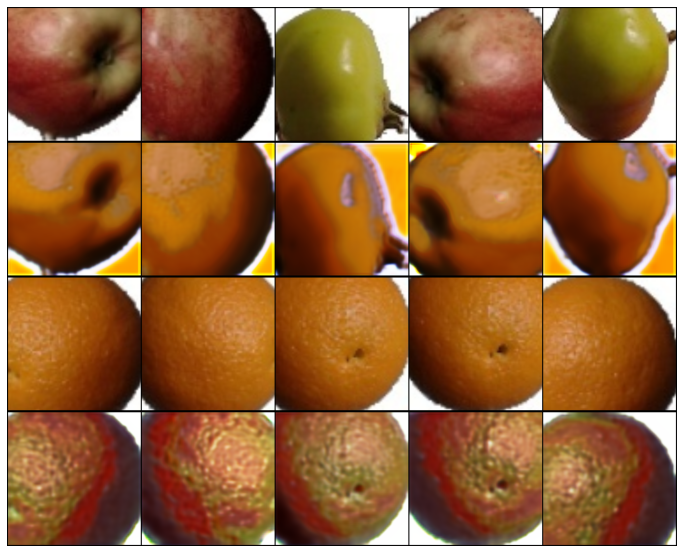

EPOCH: 0.489	loss_D: 0.133	loss_G: 1.623	loss_identity: 0.072	loss_GAN: 0.396	loss_cycle: 0.087	(1798.53s - 34950.88s remaining)

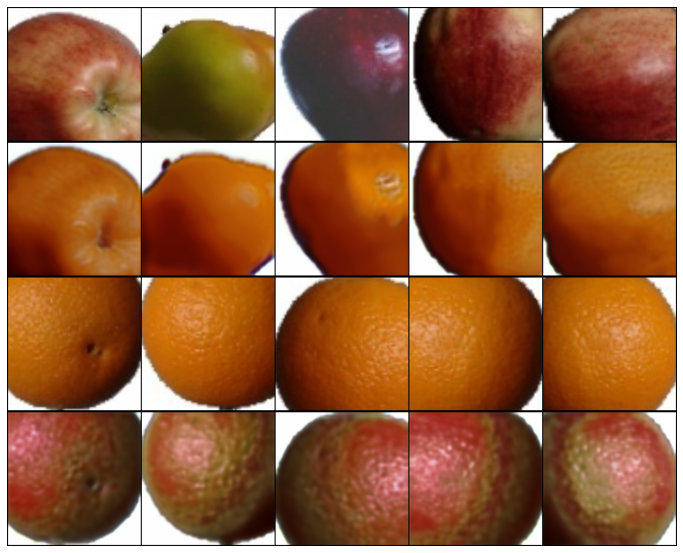

EPOCH: 0.522	loss_D: 0.174	loss_G: 2.635	loss_identity: 0.129	loss_GAN: 0.425	loss_cycle: 0.157	(1917.88s - 34822.57s remaining)

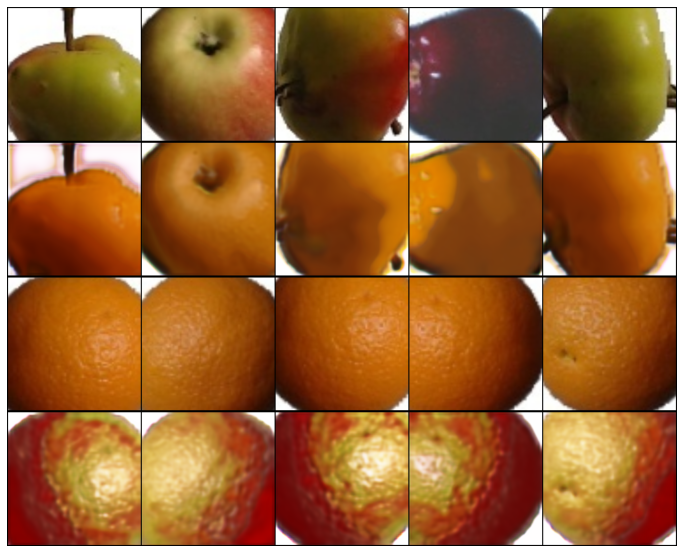

EPOCH: 0.555	loss_D: 0.220	loss_G: 1.703	loss_identity: 0.072	loss_GAN: 0.510	loss_cycle: 0.084	(2036.59s - 34684.32s remaining)

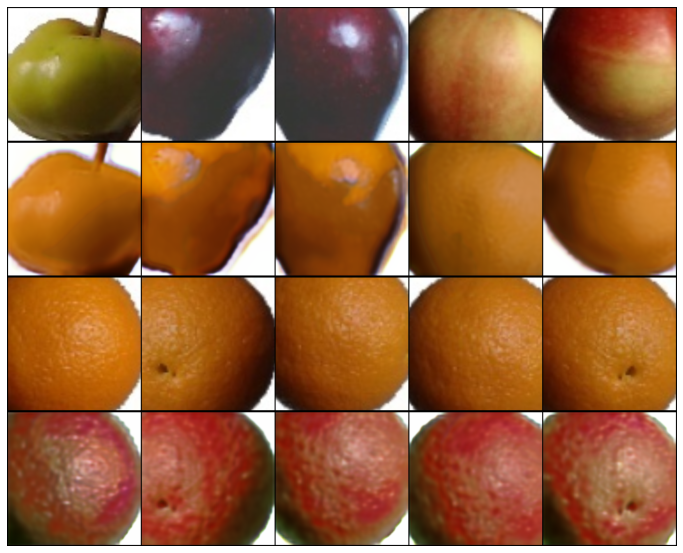

EPOCH: 0.587	loss_D: 0.187	loss_G: 1.916	loss_identity: 0.072	loss_GAN: 0.778	loss_cycle: 0.078	(2156.09s - 34560.84s remaining)

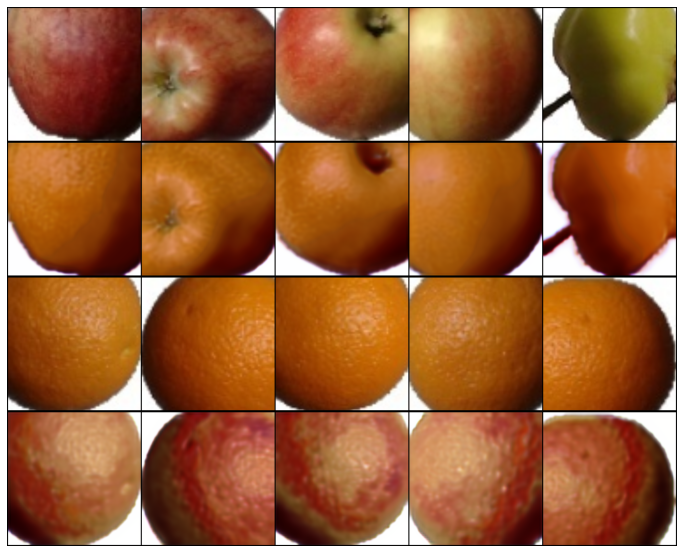

EPOCH: 0.620	loss_D: 0.356	loss_G: 2.230	loss_identity: 0.109	loss_GAN: 0.320	loss_cycle: 0.136	(2275.29s - 34433.37s remaining)

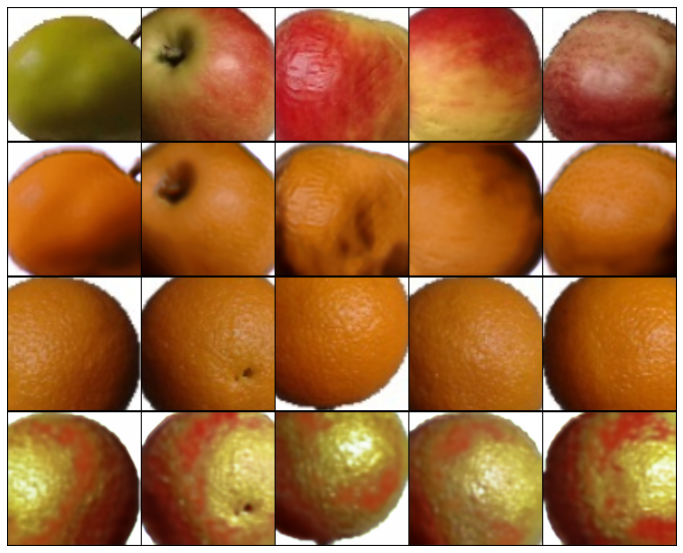

EPOCH: 0.652	loss_D: 0.200	loss_G: 2.107	loss_identity: 0.115	loss_GAN: 0.309	loss_cycle: 0.122	(2394.23s - 34302.88s remaining)

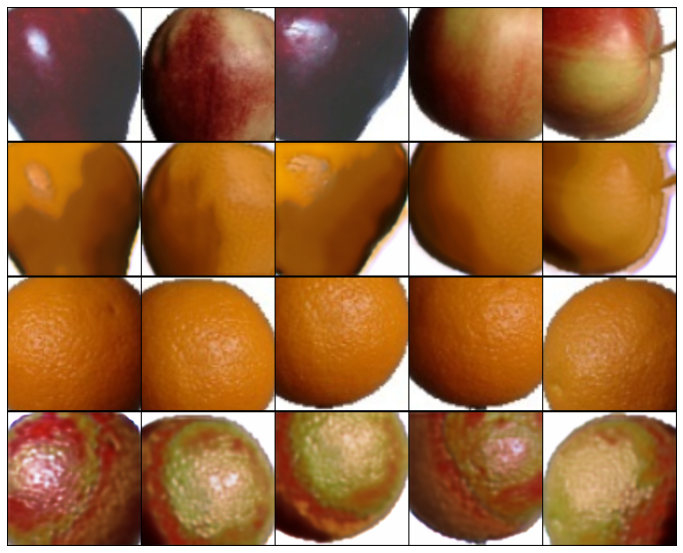

EPOCH: 0.685	loss_D: 0.202	loss_G: 1.839	loss_identity: 0.090	loss_GAN: 0.446	loss_cycle: 0.094	(2513.21s - 34174.16s remaining)

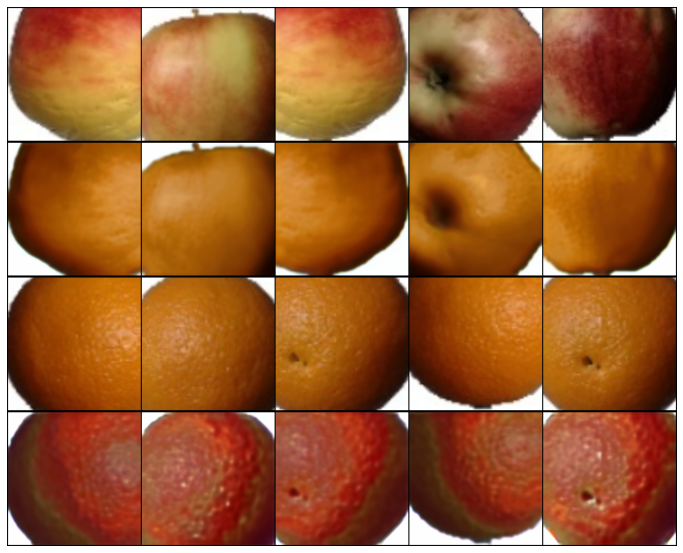

EPOCH: 0.718	loss_D: 0.141	loss_G: 1.972	loss_identity: 0.083	loss_GAN: 0.466	loss_cycle: 0.109	(2632.20s - 34046.44s remaining)

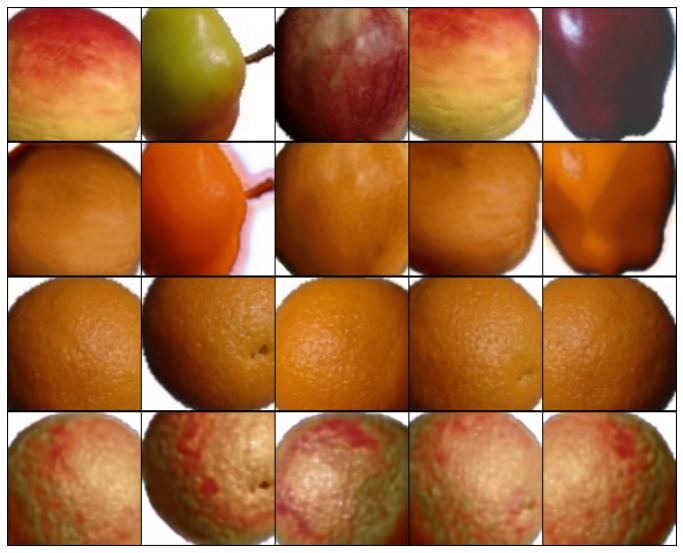

EPOCH: 0.750	loss_D: 0.226	loss_G: 1.943	loss_identity: 0.086	loss_GAN: 0.468	loss_cycle: 0.105	(2751.24s - 33919.96s remaining)

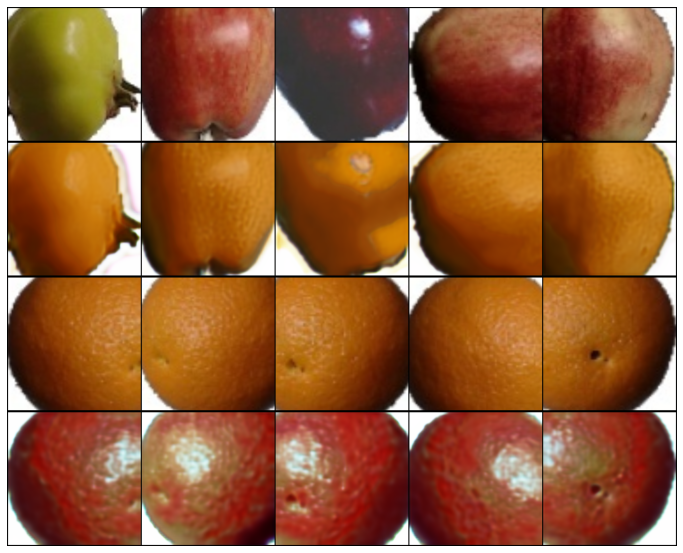

EPOCH: 0.783	loss_D: 0.109	loss_G: 1.448	loss_identity: 0.055	loss_GAN: 0.603	loss_cycle: 0.057	(2870.04s - 33791.40s remaining)

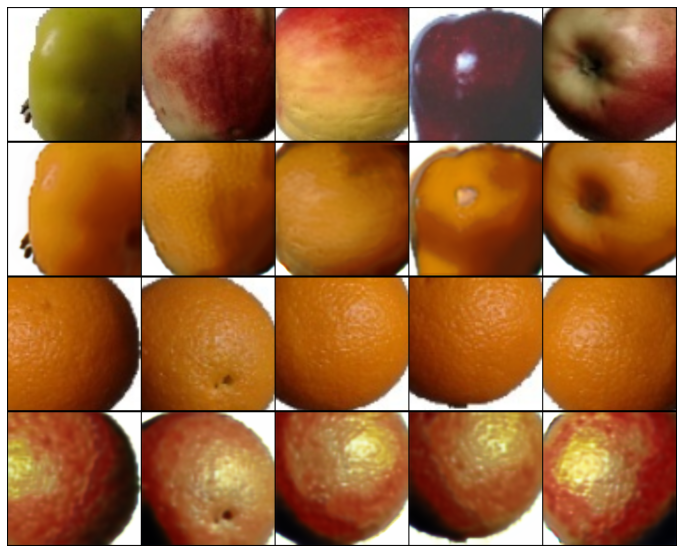

EPOCH: 0.815	loss_D: 0.268	loss_G: 2.026	loss_identity: 0.097	loss_GAN: 0.239	loss_cycle: 0.130	(2989.14s - 33666.96s remaining)

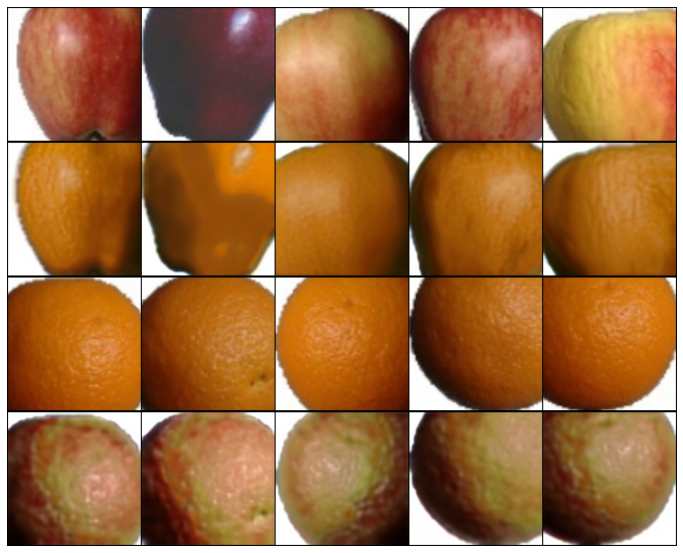

EPOCH: 0.848	loss_D: 0.223	loss_G: 2.229	loss_identity: 0.081	loss_GAN: 0.541	loss_cycle: 0.128	(3108.39s - 33544.59s remaining)

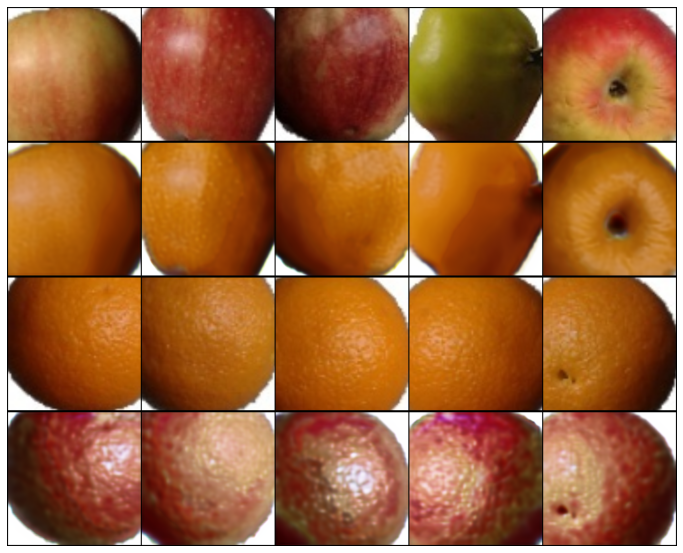

EPOCH: 0.881	loss_D: 0.281	loss_G: 2.336	loss_identity: 0.100	loss_GAN: 0.506	loss_cycle: 0.133	(3228.06s - 33426.75s remaining)

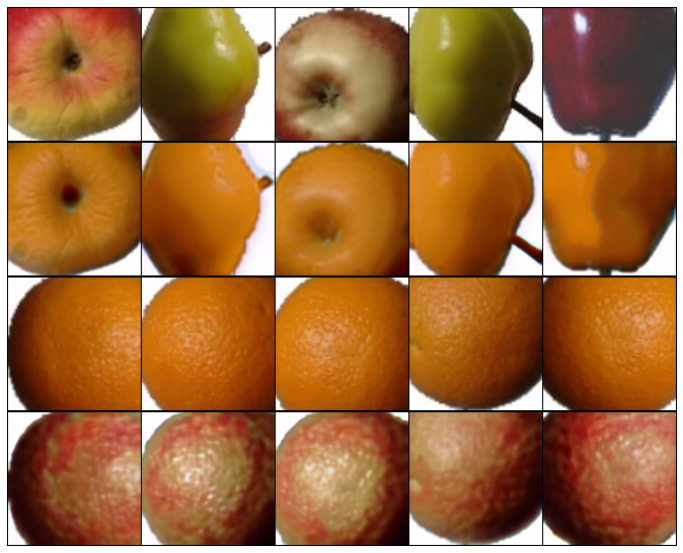

EPOCH: 0.913	loss_D: 0.258	loss_G: 2.289	loss_identity: 0.120	loss_GAN: 0.423	loss_cycle: 0.127	(3346.79s - 33299.44s remaining)

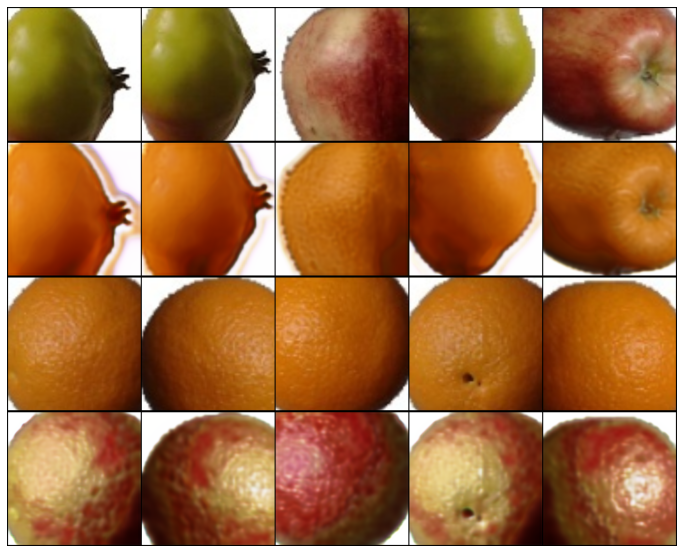

EPOCH: 0.946	loss_D: 0.308	loss_G: 2.329	loss_identity: 0.107	loss_GAN: 0.639	loss_cycle: 0.115	(3465.63s - 33173.73s remaining)

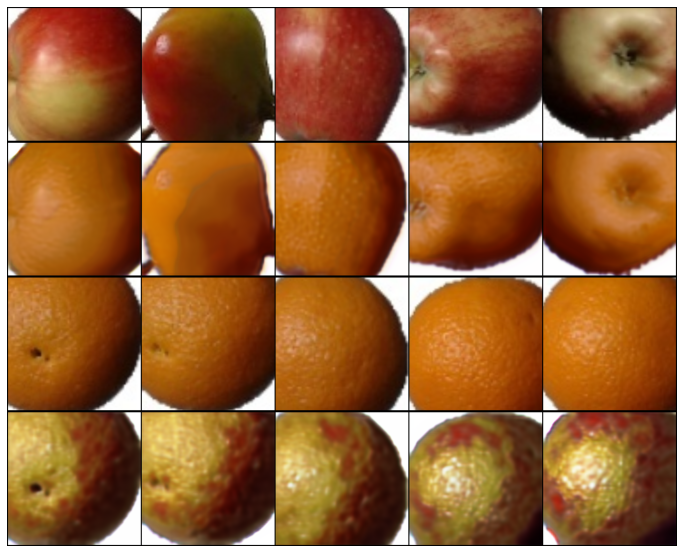

EPOCH: 0.978	loss_D: 0.096	loss_G: 1.769	loss_identity: 0.053	loss_GAN: 0.713	loss_cycle: 0.079	(3584.76s - 33051.26s remaining)

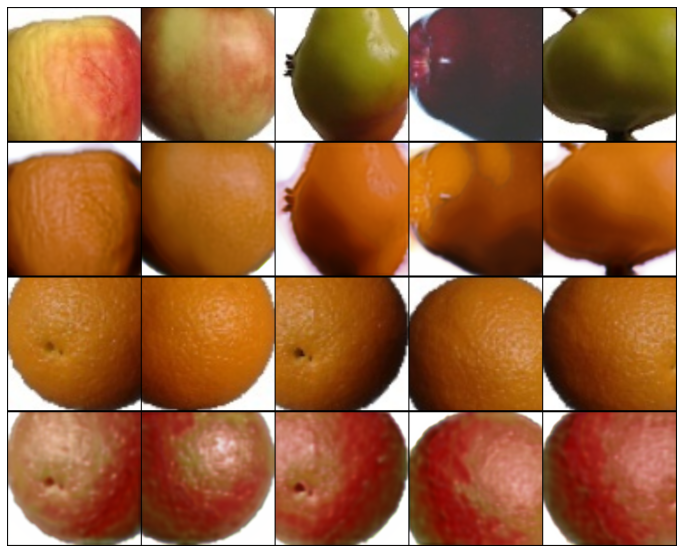

EPOCH: 1.000	loss_D: 0.232	loss_G: 2.151	loss_identity: 0.101	loss_GAN: 0.485	loss_cycle: 0.116	(3663.90s - 32975.12s remaining)
EPOCH: 1.000	loss_D: 0.201	loss_G: 1.554	loss_identity: 0.067	loss_GAN: 0.391	loss_cycle: 0.083	(3665.07s - 32973.70s remaining)

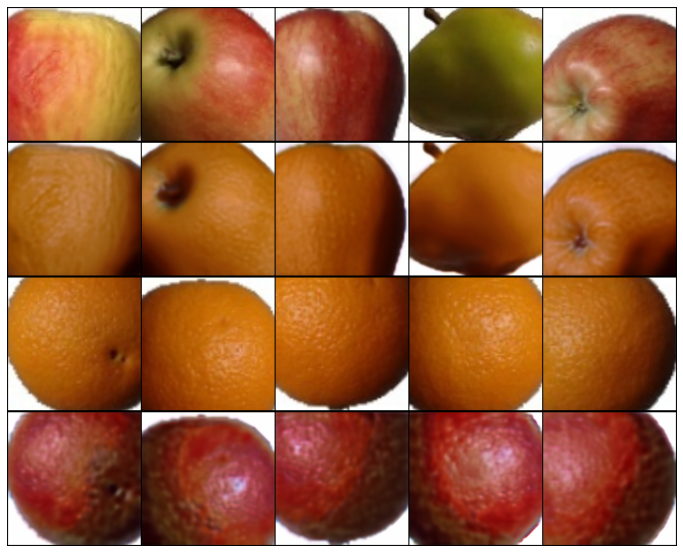

EPOCH: 1.033	loss_D: 0.076	loss_G: 2.361	loss_identity: 0.057	loss_GAN: 0.627	loss_cycle: 0.145	(3783.76s - 32847.51s remaining)

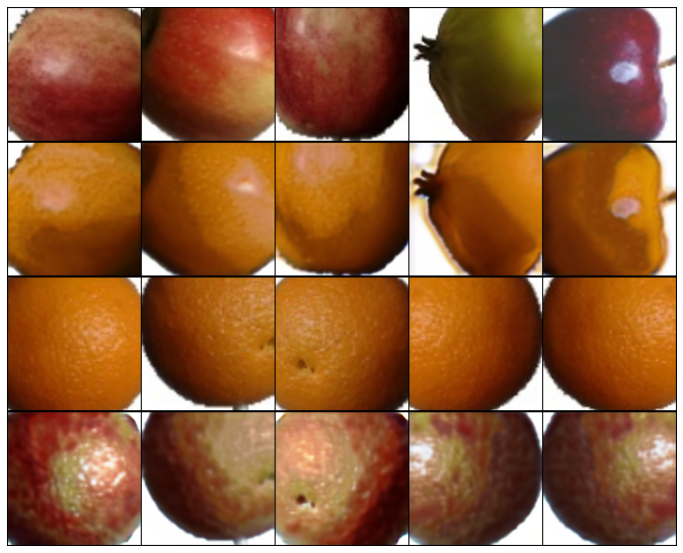

EPOCH: 1.066	loss_D: 0.152	loss_G: 1.302	loss_identity: 0.056	loss_GAN: 0.349	loss_cycle: 0.067	(3901.99s - 32717.97s remaining)

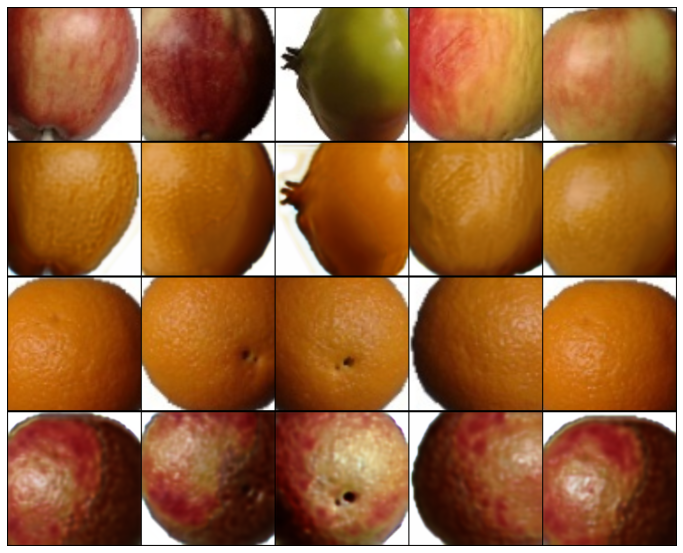

EPOCH: 1.098	loss_D: 0.154	loss_G: 1.638	loss_identity: 0.073	loss_GAN: 0.557	loss_cycle: 0.071	(4020.40s - 32590.54s remaining)

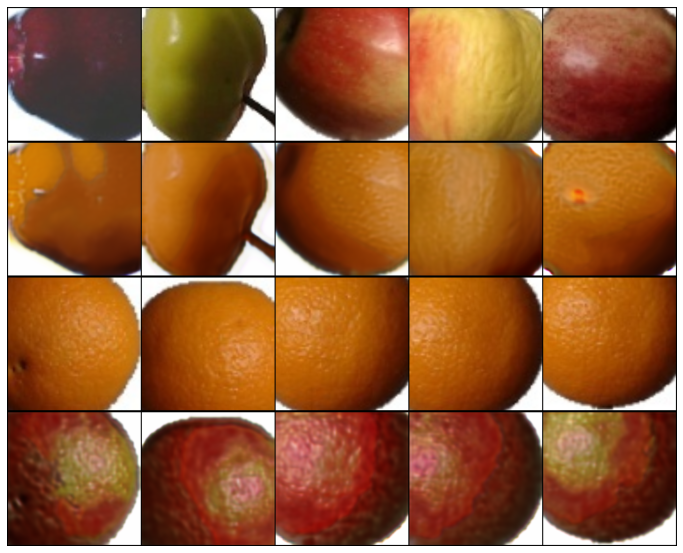

EPOCH: 1.131	loss_D: 0.122	loss_G: 1.899	loss_identity: 0.065	loss_GAN: 0.864	loss_cycle: 0.071	(4139.65s - 32470.21s remaining)

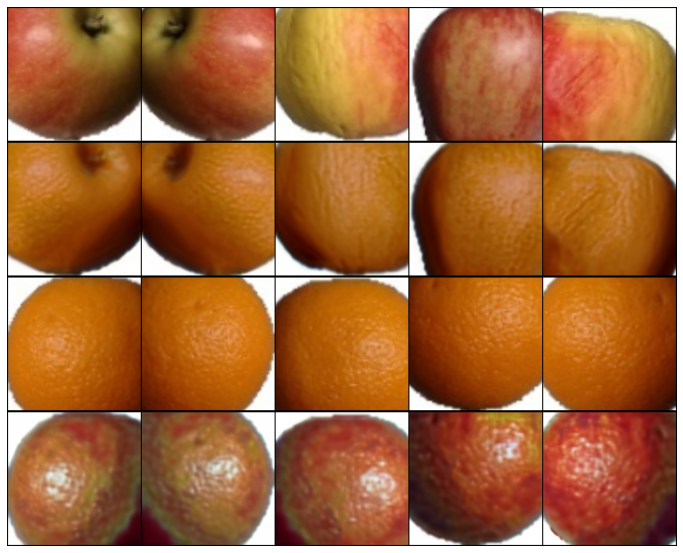

EPOCH: 1.163	loss_D: 0.223	loss_G: 1.757	loss_identity: 0.073	loss_GAN: 0.601	loss_cycle: 0.079	(4259.24s - 32352.54s remaining)

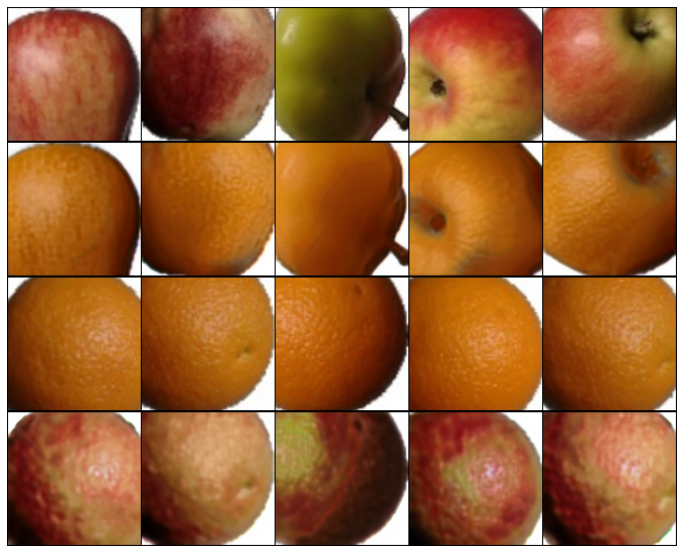

EPOCH: 1.196	loss_D: 0.189	loss_G: 1.629	loss_identity: 0.072	loss_GAN: 0.436	loss_cycle: 0.083	(4377.96s - 32228.39s remaining)

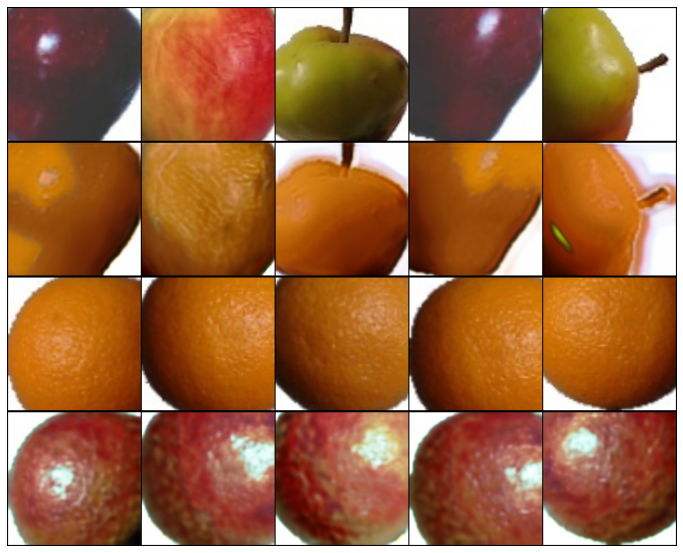

EPOCH: 1.229	loss_D: 0.175	loss_G: 1.958	loss_identity: 0.076	loss_GAN: 0.549	loss_cycle: 0.103	(4496.59s - 32103.86s remaining)

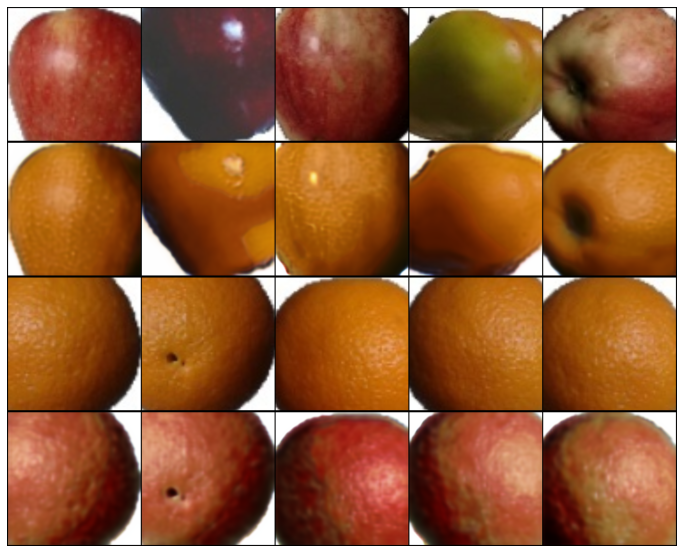

EPOCH: 1.261	loss_D: 0.175	loss_G: 1.871	loss_identity: 0.058	loss_GAN: 0.883	loss_cycle: 0.070	(4616.65s - 31989.51s remaining)

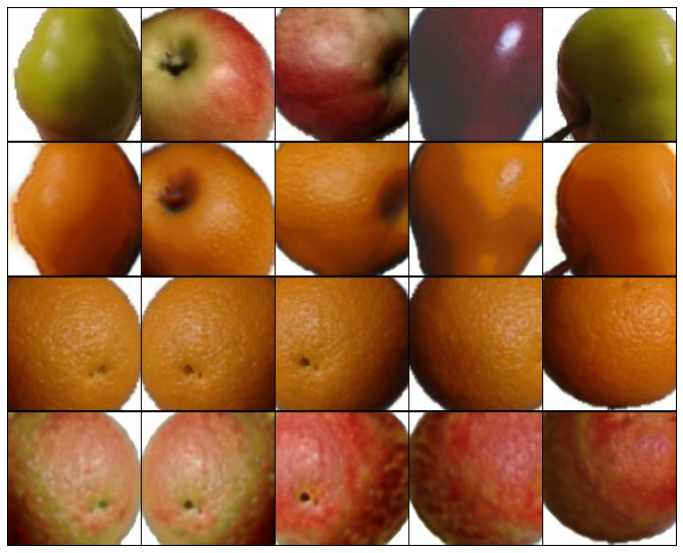

EPOCH: 1.294	loss_D: 0.325	loss_G: 1.458	loss_identity: 0.064	loss_GAN: 0.418	loss_cycle: 0.072	(4736.53s - 31873.69s remaining)

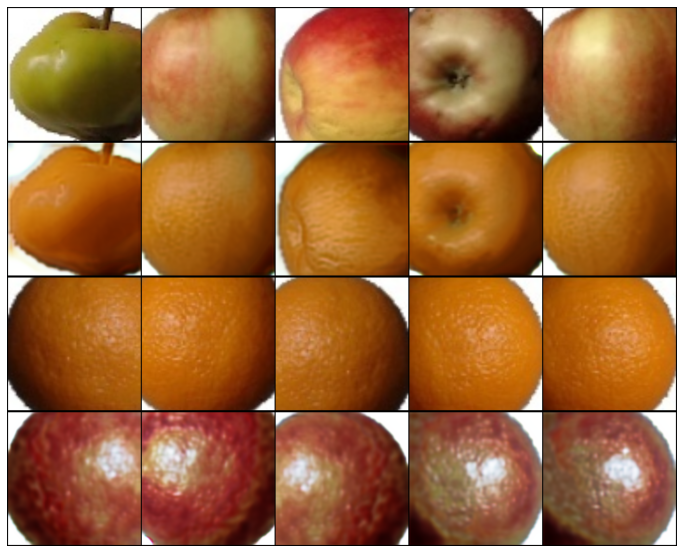

EPOCH: 1.326	loss_D: 0.322	loss_G: 1.405	loss_identity: 0.055	loss_GAN: 0.414	loss_cycle: 0.071	(4856.14s - 31755.92s remaining)

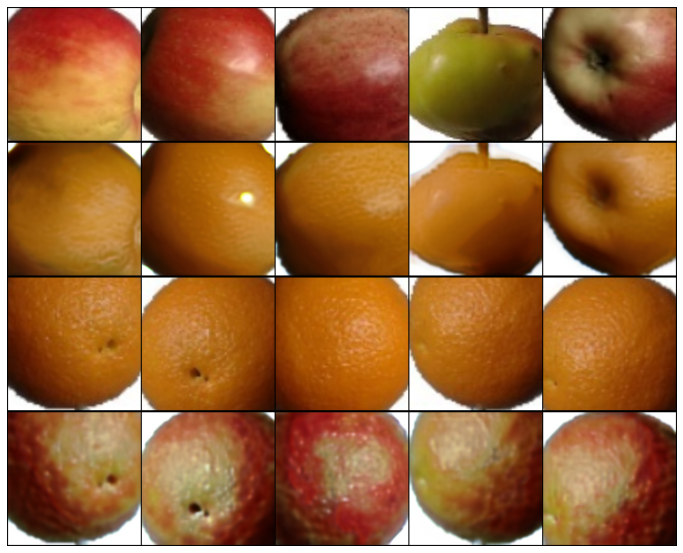

EPOCH: 1.359	loss_D: 0.123	loss_G: 1.816	loss_identity: 0.076	loss_GAN: 0.439	loss_cycle: 0.100	(4975.57s - 31636.87s remaining)

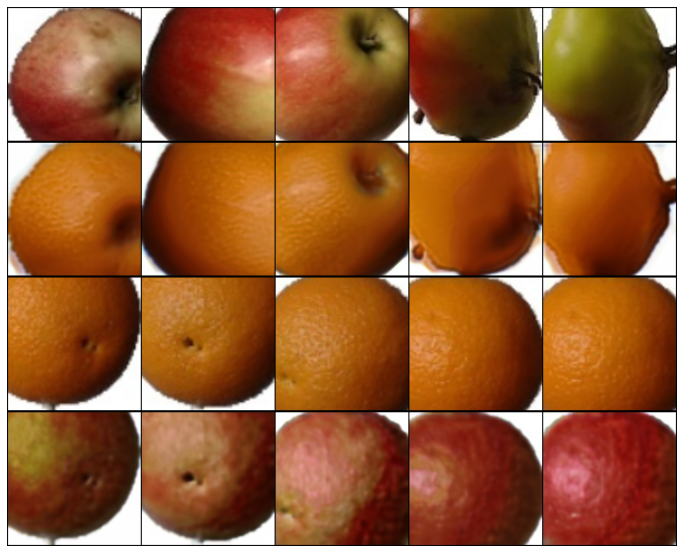

EPOCH: 1.392	loss_D: 0.146	loss_G: 1.644	loss_identity: 0.073	loss_GAN: 0.482	loss_cycle: 0.080	(5094.86s - 31516.98s remaining)

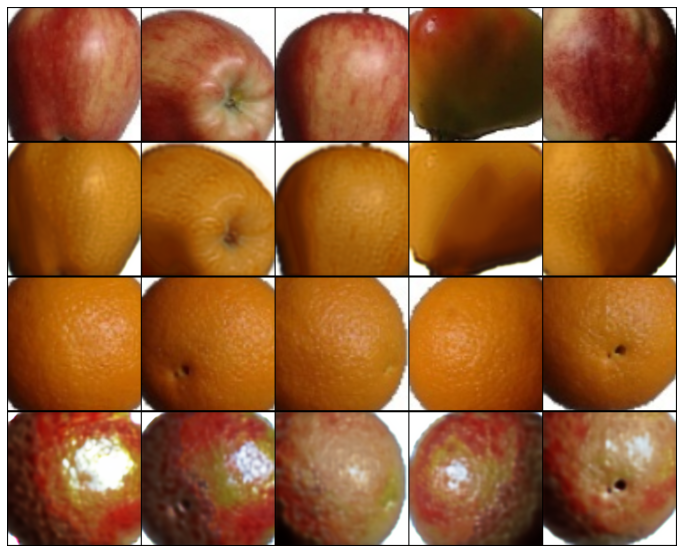

EPOCH: 1.424	loss_D: 0.290	loss_G: 1.353	loss_identity: 0.048	loss_GAN: 0.400	loss_cycle: 0.071	(5214.20s - 31397.40s remaining)

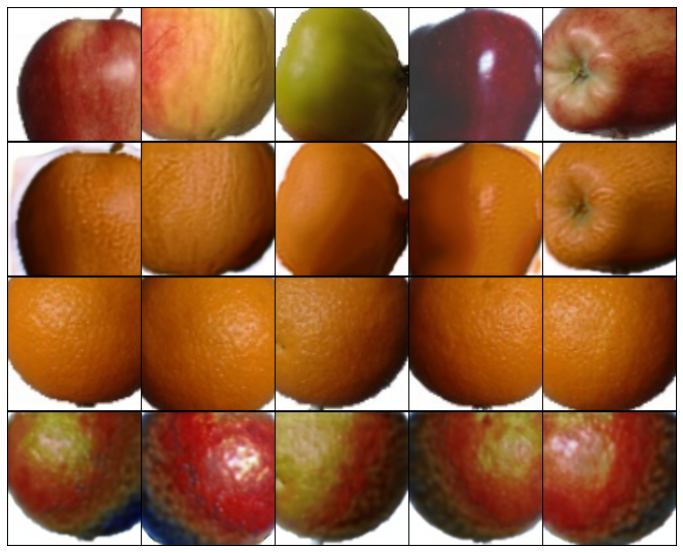

EPOCH: 1.457	loss_D: 0.228	loss_G: 1.519	loss_identity: 0.054	loss_GAN: 0.477	loss_cycle: 0.077	(5333.77s - 31279.19s remaining)

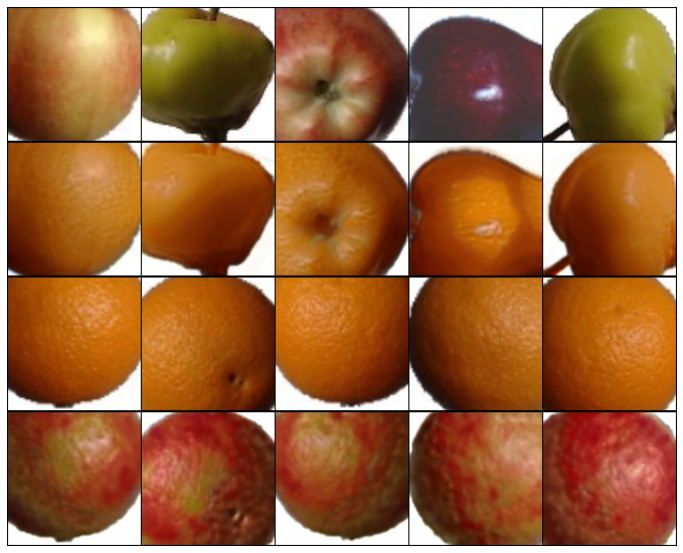

EPOCH: 1.489	loss_D: 0.161	loss_G: 1.759	loss_identity: 0.079	loss_GAN: 0.466	loss_cycle: 0.090	(5453.89s - 31164.07s remaining)

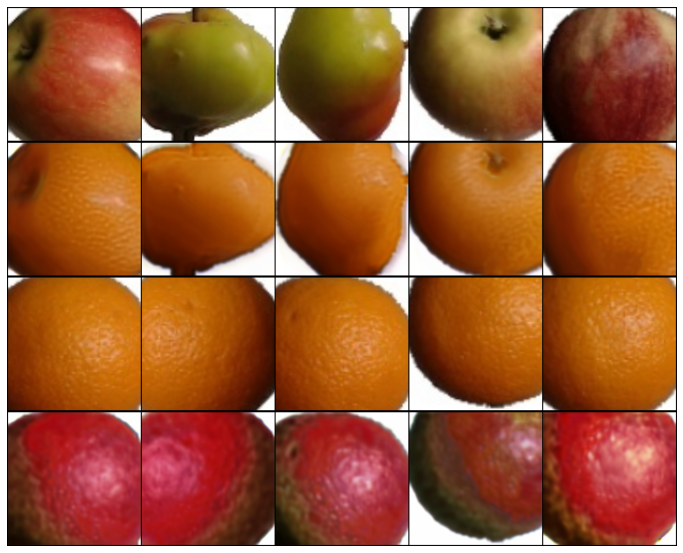

EPOCH: 1.522	loss_D: 0.191	loss_G: 1.287	loss_identity: 0.037	loss_GAN: 0.464	loss_cycle: 0.064	(5573.39s - 31045.27s remaining)

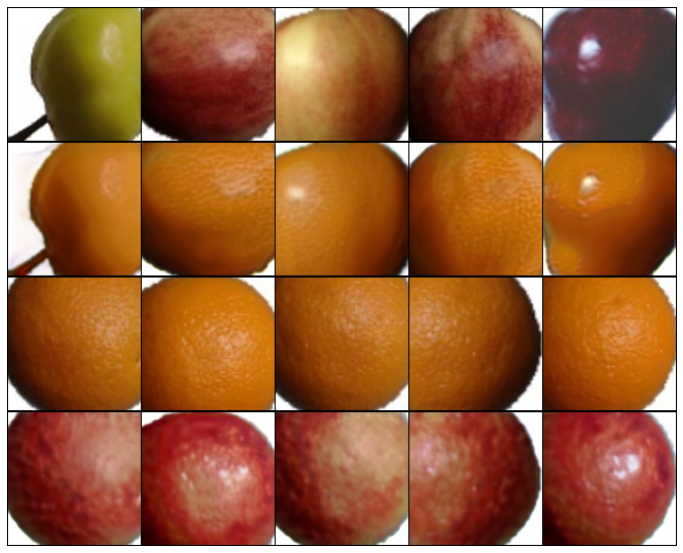

EPOCH: 1.555	loss_D: 0.210	loss_G: 1.614	loss_identity: 0.050	loss_GAN: 0.593	loss_cycle: 0.077	(5692.75s - 30925.67s remaining)

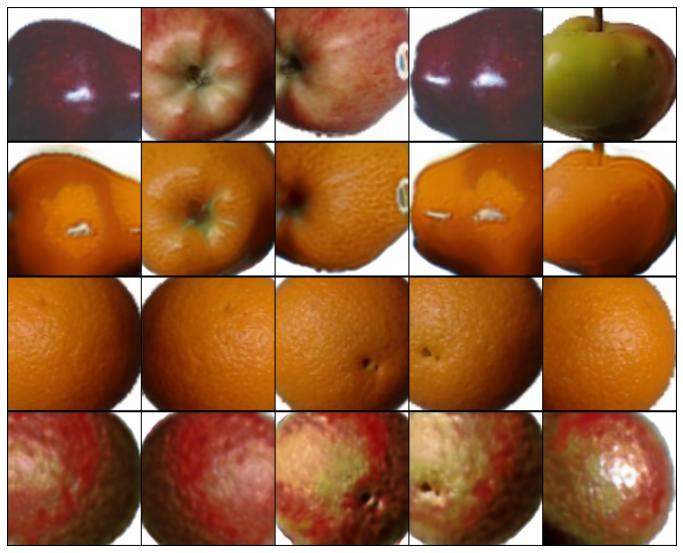

EPOCH: 1.587	loss_D: 0.357	loss_G: 1.268	loss_identity: 0.065	loss_GAN: 0.240	loss_cycle: 0.070	(5812.62s - 30808.78s remaining)

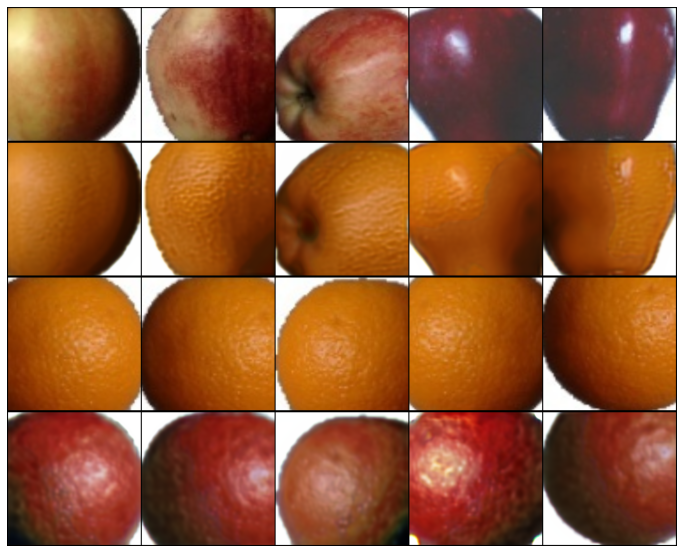

EPOCH: 1.614	loss_D: 0.222	loss_G: 1.686	loss_identity: 0.080	loss_GAN: 0.506	loss_cycle: 0.078	(5910.99s - 30713.24s remaining)

KeyboardInterrupt: 

In [ ]:
# TODO: Train the networks over increasing epochs:
def train_model(train_loader=train_loader, G_AB=G_AB, G_BA=G_BA, D_A=D_A, D_B=D_B, optimizer_G=optimizer_G, optimizer_D_A=optimizer_D_A,
                optimizer_D_B=optimizer_D_B):
    n_epochs = 10
    log = Report(n_epochs)
    for epoch in range(n_epochs):
        N = len(train_loader)
        for bx, batch in enumerate(train_loader):
            real_A, real_B = batch
            loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B, = \
                generator_train_step((G_AB, G_BA), optimizer_G, real_A, real_B)

            loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
            loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)

            loss_D = (loss_D_A + loss_D_B) / 2

            log.record(pos=epoch + (1 + bx) / N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                       loss_identity=loss_identity.item(),
                       loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(), end='\r')
            if bx % 100 == 0: generate_sample()
        log.report_avgs(epoch + 1)



# n_epochs = 10
# log = Report(n_epochs)
# for epoch in range(n_epochs):
#     N = len(train_loader)
#     for bx, batch in enumerate(train_loader):
#         real_A, real_B = batch

#         loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB,G_BA), optimizer_G, real_A, real_B)
#         loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
#         loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
#         loss_D = (loss_D_A + loss_D_B) / 2
        
#         log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(), 
#                    loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(), 
#                    loss_identity=loss_identity.item(), end='\r')
#         if bx%100==0: generate_sample()

#     log.report_avgs(epoch+1)

In [ ]:
train_model()